- https://www.alignmentforum.org/posts/qykrYY6rXXM7EEs8Q/understanding-sae-features-with-the-logit-lens
- https://colab.research.google.com/github/jbloomAus/SAELens/blob/main/tutorials/logits_lens_with_features.ipynb

- sae.W_dec @ model.W_U: (24576, 50257),
    - W_dec.shape: [24576, 768]
        - 24576 每一个均可视为是一个 feature
        - W_enc.shape: [768, 24576], (768 * 32)
    - model.W_U.shape: [768, 50257]
    - 768 => 50257
    - sae dictionary 中的每个 feature（768维）与vocab中的每个 token（768维） 做内积，score；
        - 特征对词表的投影分数
    - `W_dec @ model.W_U.detach().cpu()` => dec_projection_onto_W_U
- tsea：token set enrichment analysis（将传统的基因集富集分析方法应用到了 token/词汇分析领域）
    - gene sets：基因集
        - baby_name_sets
        - pos_sets：Part of Speech（词性）
    - enrichment analysis：富集分析；
    - GSEA => TSEA

In [38]:
24576/768

32.0

In [1]:
from IPython.display import Image
import os
os.environ['http_proxy'] = 'http://127.0.0.1:7890'
os.environ['https_proxy'] = 'http://127.0.0.1:7890'

In [2]:
import plotly_express as px

In [3]:
import numpy as np

In [4]:
from transformer_lens import HookedTransformer
from sae_lens import SAE
# Virtual Weight / Feature Statistics Functions
from sae_lens.analysis.feature_statistics import (
    get_all_stats_dfs,
    get_W_U_W_dec_stats_df,
    get_stats_df
)

In [5]:
from sae_lens.analysis.neuronpedia_integration import get_neuronpedia_quick_list

In [86]:
# Enrichment Analysis Functions
from sae_lens.analysis.tsea import (
    get_enrichment_df,
    manhattan_plot_enrichment_scores,
    plot_top_k_feature_projections_by_token_and_category,
)
from sae_lens.analysis.tsea import (
    get_baby_name_sets,
    get_letter_gene_sets,
    generate_pos_sets,
    get_test_gene_sets,
    get_gene_set_from_regex,
)

###  Loading GPT2 Small and SAE Weights

In [6]:
model = HookedTransformer.from_pretrained("gpt2-small")

/home/whaow/anaconda3/lib/python3.10/site-packages/transformers/tokenization_utils_base.py:1602: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be deprecated in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Loaded pretrained model gpt2-small into HookedTransformer


In [7]:
# 'n_layers': 12,
# 'd_model': 768, 'd_head': 64, 'n_heads': 12,
model.cfg

HookedTransformerConfig:
{'NTK_by_parts_factor': 8.0,
 'NTK_by_parts_high_freq_factor': 4.0,
 'NTK_by_parts_low_freq_factor': 1.0,
 'act_fn': 'gelu_new',
 'attention_dir': 'causal',
 'attn_only': False,
 'attn_scale': 8.0,
 'attn_scores_soft_cap': -1.0,
 'attn_types': None,
 'checkpoint_index': None,
 'checkpoint_label_type': None,
 'checkpoint_value': None,
 'd_head': 64,
 'd_mlp': 3072,
 'd_model': 768,
 'd_vocab': 50257,
 'd_vocab_out': 50257,
 'decoder_start_token_id': None,
 'default_prepend_bos': True,
 'device': device(type='cuda'),
 'dtype': torch.float32,
 'eps': 1e-05,
 'experts_per_token': None,
 'final_rms': False,
 'from_checkpoint': False,
 'gated_mlp': False,
 'init_mode': 'gpt2',
 'init_weights': False,
 'initializer_range': 0.02886751345948129,
 'load_in_4bit': False,
 'model_name': 'gpt2',
 'n_ctx': 1024,
 'n_devices': 1,
 'n_heads': 12,
 'n_key_value_heads': None,
 'n_layers': 12,
 'n_params': 84934656,
 'normalization_type': 'LNPre',
 'num_experts': None,
 'original

In [8]:
gpt2_small_sparse_autoencoders = {}
gpt2_small_sae_sparsities = {}

for layer in range(12):
    sae, original_cfg_dict, sparsity = SAE.from_pretrained(
        release="gpt2-small-res-jb",
        sae_id="blocks.0.hook_resid_pre",
        device="cpu",
    )
    gpt2_small_sparse_autoencoders[f"blocks.{layer}.hook_resid_pre"] = sae
    gpt2_small_sae_sparsities[f"blocks.{layer}.hook_resid_pre"] = sparsity

/home/whaow/anaconda3/lib/python3.10/site-packages/sae_lens/sae.py:145: UserWarning: 
This SAE has non-empty model_from_pretrained_kwargs. 
For optimal performance, load the model like so:
model = HookedSAETransformer.from_pretrained_no_processing(..., **cfg.model_from_pretrained_kwargs)
  warnings.warn(


### Statistical Properties of Feature Logit Distributions

In [9]:
# In the post, I focus on layer 8
layer = 8

In [10]:
# get the corresponding SAE and feature sparsities.
sparse_autoencoder = gpt2_small_sparse_autoencoders[f"blocks.{layer}.hook_resid_pre"]
log_feature_sparsity = gpt2_small_sae_sparsities[f"blocks.{layer}.hook_resid_pre"]

In [11]:
sparse_autoencoder

SAE(
  (activation_fn): ReLU()
  (hook_sae_input): HookPoint()
  (hook_sae_acts_pre): HookPoint()
  (hook_sae_acts_post): HookPoint()
  (hook_sae_output): HookPoint()
  (hook_sae_recons): HookPoint()
  (hook_sae_error): HookPoint()
)

In [12]:
log_feature_sparsity.shape

torch.Size([24576])

In [13]:
24576 / model.cfg.d_model

32.0

In [14]:
sparse_autoencoder.W_enc.shape, sparse_autoencoder.W_dec.shape

(torch.Size([768, 24576]), torch.Size([24576, 768]))

In [15]:
W_dec = sparse_autoencoder.W_dec

In [36]:
sparse_autoencoder.W_enc.shape, W_dec.shape

(torch.Size([768, 24576]), torch.Size([24576, 768]))

In [16]:
model.W_U.shape

torch.Size([768, 50257])

In [17]:
get_W_U_W_dec_stats_df??

Signature:
get_W_U_W_dec_stats_df(
    W_dec: torch.Tensor,
    model: transformer_lens.HookedTransformer.HookedTransformer,
    cosine_sim: bool = False,
) -> tuple[pandas.core.frame.DataFrame, torch.Tensor]
Docstring: <no docstring>
Source:   
@torch.no_grad()
def get_W_U_W_dec_stats_df(
    W_dec: torch.Tensor, model: HookedTransformer, cosine_sim: bool = False
) -> tuple[pd.DataFrame, torch.Tensor]:
    W_U = model.W_U.detach().cpu()
    if cosine_sim:
        W_U = W_U / W_U.norm(dim=0, keepdim=True)
    dec_projection_onto_W_U = W_dec @ W_U
    W_U_stats_df = get_stats_df(dec_projection_onto_W_U)
    return W_U_stats_df, dec_projection_onto_W_U
File:      ~/anaconda3/lib/python3.10/site-packages/sae_lens/analysis/feature_statistics.py
Type:      function

In [18]:
W_dec.device

device(type='cpu')

In [19]:
W_dec.device

device(type='cpu')

In [20]:
model.W_U.device

device(type='cuda', index=0)

In [21]:
get_stats_df??

Signature: get_stats_df(projection: torch.Tensor)
Source:   
@torch.no_grad()
def get_stats_df(projection: torch.Tensor):
    """
    Returns a dataframe with the mean, std, skewness and kurtosis of the projection
    """
    mean = projection.mean(dim=1, keepdim=True)
    diffs = projection - mean
    var = (diffs**2).mean(dim=1, keepdim=True)
    std = torch.pow(var, 0.5)
    zscores = diffs / std
    skews = torch.mean(torch.pow(zscores, 3.0), dim=1)
    kurtosis = torch.mean(torch.pow(zscores, 4.0), dim=1)

    stats_df = pd.DataFrame(
        {
            "feature": range(len(skews)),
            "mean": mean.numpy().squeeze(),
            "std": std.numpy().squeeze(),
            "skewness": skews.numpy(),
            "kurtosis": kurtosis.numpy(),
        }
    )

    return stats_df
File:      ~/anaconda3/lib/python3.10/site-packages/sae_lens/analysis/feature_statistics.py
Type:      function

In [22]:
# calculate the statistics of the logit weight distributions
W_U_stats_df_dec, dec_projection_onto_W_U = get_W_U_W_dec_stats_df(
    W_dec, model, cosine_sim=False
)

In [23]:
# W_dec @ model.W_U.detach().cpu()
# 768 (from W_dec) project to 50257 (W_U)
dec_projection_onto_W_U.shape

torch.Size([24576, 50257])

In [24]:
W_U_stats_df_dec.shape

(24576, 5)

In [25]:
W_U_stats_df_dec.head()

,feature,mean,std,skewness,kurtosis
0,0,7.590380e-11,0.189715,0.764198,9.097913
1,1,-9.260264e-09,0.166483,0.083962,3.300045
2,2,-4.554228e-10,0.203762,0.698958,6.764234
3,3,1.518076e-09,0.189168,0.627483,8.012762
4,4,-1.457353e-08,0.234610,1.676332,10.387129


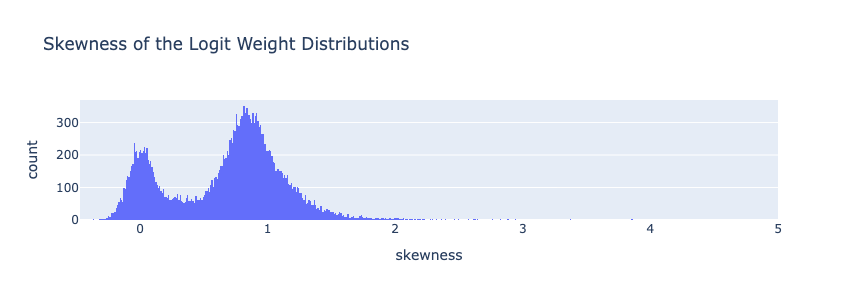

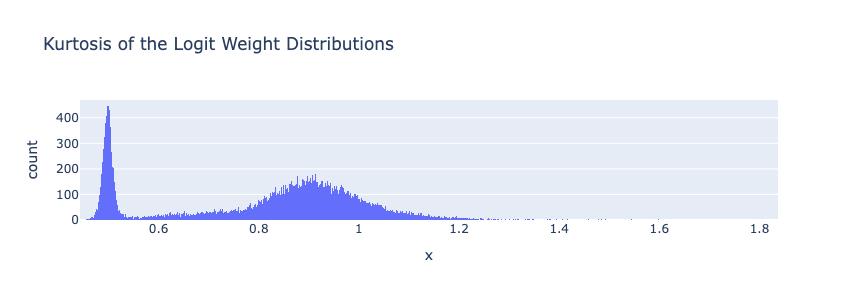

In [26]:
px.histogram(
    W_U_stats_df_dec,
    x="skewness",
    width=800,
    height=300,
    nbins=1000,
    title="Skewness of the Logit Weight Distributions",
).show()

px.histogram(
    W_U_stats_df_dec,
    x=np.log10(W_U_stats_df_dec["kurtosis"]),
    width=800,
    height=300,
    nbins=1000,
    title="Kurtosis of the Logit Weight Distributions",
).show()

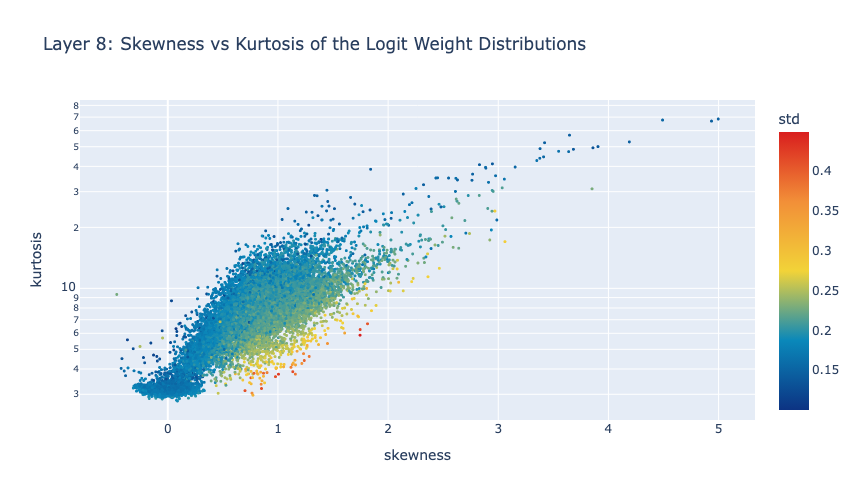

In [27]:
fig = px.scatter(
    W_U_stats_df_dec,
    x="skewness",
    y="kurtosis",
    color="std",
    color_continuous_scale="Portland",
    hover_name="feature",
    width=800,
    height=500,
    log_y=True,  # Kurtosis has larger outliers so logging creates a nicer scale.
    labels={"x": "Skewness", "y": "Kurtosis", "color": "Standard Deviation"},
    title=f"Layer {8}: Skewness vs Kurtosis of the Logit Weight Distributions",
)

# decrease point size
fig.update_traces(marker=dict(size=3))


fig.show()

In [28]:
# then you can query accross combinations of the statistics to find features of interest and open them in neuronpedia.
tmp_df = W_U_stats_df_dec[["feature", "skewness", "kurtosis", "std"]]
# tmp_df = tmp_df[(tmp_df["std"] > 0.04)]
# tmp_df = tmp_df[(tmp_df["skewness"] > 0.65)]
tmp_df = tmp_df[(tmp_df["skewness"] > 3)]
tmp_df = tmp_df.sort_values("skewness", ascending=False).head(10)
display(tmp_df)

# if desired, open the features in neuronpedia
get_neuronpedia_quick_list(sparse_autoencoder, list(tmp_df.feature))

,feature,skewness,kurtosis,std
21461,21461,4.997022,68.520027,0.147476
2243,2243,4.935740,66.889091,0.145082
23720,23720,4.491526,67.694000,0.153658
419,419,4.189988,52.835106,0.145135
18710,18710,3.905093,50.059891,0.139519
14941,14941,3.859169,49.382679,0.134501
21407,21407,3.851373,30.988358,0.228910
10615,10615,3.682018,48.561260,0.138532
10442,10442,3.646617,57.019684,0.145679
18654,18654,3.638960,47.288048,0.157968


'https://neuronpedia.org/quick-list/?name=temporary_list&features=%5B%7B%22modelId%22%3A%20%22gpt2-small%22%2C%20%22layer%22%3A%20%220-res-jb%22%2C%20%22index%22%3A%20%2221461%22%7D%2C%20%7B%22modelId%22%3A%20%22gpt2-small%22%2C%20%22layer%22%3A%20%220-res-jb%22%2C%20%22index%22%3A%20%222243%22%7D%2C%20%7B%22modelId%22%3A%20%22gpt2-small%22%2C%20%22layer%22%3A%20%220-res-jb%22%2C%20%22index%22%3A%20%2223720%22%7D%2C%20%7B%22modelId%22%3A%20%22gpt2-small%22%2C%20%22layer%22%3A%20%220-res-jb%22%2C%20%22index%22%3A%20%22419%22%7D%2C%20%7B%22modelId%22%3A%20%22gpt2-small%22%2C%20%22layer%22%3A%20%220-res-jb%22%2C%20%22index%22%3A%20%2218710%22%7D%2C%20%7B%22modelId%22%3A%20%22gpt2-small%22%2C%20%22layer%22%3A%20%220-res-jb%22%2C%20%22index%22%3A%20%2214941%22%7D%2C%20%7B%22modelId%22%3A%20%22gpt2-small%22%2C%20%22layer%22%3A%20%220-res-jb%22%2C%20%22index%22%3A%20%2221407%22%7D%2C%20%7B%22modelId%22%3A%20%22gpt2-small%22%2C%20%22layer%22%3A%20%220-res-jb%22%2C%20%22index%22%3A%20%2210615%2

In [29]:
tmp_df.feature

21461    21461
2243      2243
23720    23720
419        419
18710    18710
14941    14941
21407    21407
10615    10615
10442    10442
18654    18654
Name: feature, dtype: int64

### Token Set Enrichment Analysis

- we look at features with higher skew 

In [30]:
import nltk

nltk.download("averaged_perceptron_tagger")

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/whaow/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [31]:
vocab = model.tokenizer.get_vocab() 

In [32]:
type(vocab)

dict

In [48]:
model.tokenizer.encode('hello world'), model.tokenizer.tokenize('hello world')

([31373, 995], ['hello', 'Ġworld'])

In [47]:
vocab['world'], vocab['Ġworld']

(6894, 995)

In [40]:
regex_dict = {
    "starts_with_space": r"Ġ.*",
    "starts_with_capital": r"^Ġ*[A-Z].*",
    "starts_with_lower": r"^Ġ*[a-z].*",
    "all_digits": r"^Ġ*\d+$",
    "is_punctuation": r"^[^\w\s]+$",
    "contains_close_bracket": r".*\).*",
    "contains_open_bracket": r".*\(.*",
    "all_caps": r"Ġ*[A-Z]+$",
    "1 digit": r"Ġ*\d{1}$",
    "2 digits": r"Ġ*\d{2}$",
    "3 digits": r"Ġ*\d{3}$",
    "4 digits": r"Ġ*\d{4}$",
    "length_1": r"^Ġ*\w{1}$",
    "length_2": r"^Ġ*\w{2}$",
    "length_3": r"^Ġ*\w{3}$",
    "length_4": r"^Ġ*\w{4}$",
    "length_5": r"^Ġ*\w{5}$",
}

In [64]:
# get_letter_gene_sets??

In [65]:
all_token_sets = get_letter_gene_sets(vocab)

In [66]:
all_token_sets.keys()

dict_keys(['a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z'])

In [67]:
for key, value in regex_dict.items():
    gene_set = get_gene_set_from_regex(vocab, value)
    all_token_sets[key] = gene_set

In [68]:
all_token_sets.keys()

dict_keys(['a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z', 'starts_with_space', 'starts_with_capital', 'starts_with_lower', 'all_digits', 'is_punctuation', 'contains_close_bracket', 'contains_open_bracket', 'all_caps', '1 digit', '2 digits', '3 digits', '4 digits', 'length_1', 'length_2', 'length_3', 'length_4', 'length_5'])

In [69]:
# some other sets that can be interesting
baby_name_sets = get_baby_name_sets(vocab)
pos_sets = generate_pos_sets(vocab)
arbitrary_sets = get_test_gene_sets(model)

In [71]:
baby_name_sets.keys()

dict_keys(['boy_names', 'girl_names'])

In [76]:
arbitrary_sets.keys()

dict_keys(["1910's", "1920's", "1930's", "1940's", "1950's", "1960's", "1970's", "1980's", "1990's", "2000's", "2010's", 'colors', 'positive_words', 'negative_words', 'emotions', 'boys_names', 'girls_names', 'spanish_words', 'french_words', 'neuroscience_terms', 'economics_terms', 'capital_cities', 'countries', 'jewish_last_names', 'ologies'])

In [77]:
all_token_sets = {**all_token_sets, **pos_sets}
all_token_sets = {**all_token_sets, **arbitrary_sets}
all_token_sets = {**all_token_sets, **baby_name_sets}

In [79]:
all_token_sets.keys()

dict_keys(['a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z', 'starts_with_space', 'starts_with_capital', 'starts_with_lower', 'all_digits', 'is_punctuation', 'contains_close_bracket', 'contains_open_bracket', 'all_caps', '1 digit', '2 digits', '3 digits', '4 digits', 'length_1', 'length_2', 'length_3', 'length_4', 'length_5', 'nltk_pos_NN', 'nltk_pos_RB', 'nltk_pos_VBN', 'nltk_pos_VBG', 'nltk_pos_CD', 'nltk_pos_NNS', 'nltk_pos_NNP', 'nltk_pos_VBD', 'nltk_pos_JJ', 'nltk_pos_VBZ', 'nltk_pos_IN', 'nltk_pos_VB', 'nltk_pos_JJS', 'nltk_pos_MD', 'nltk_pos_,', 'nltk_pos_PRP$', 'nltk_pos_DT', 'nltk_pos_CC', 'nltk_pos_JJR', 'nltk_pos_WP', 'nltk_pos_PRP', 'nltk_pos_WDT', 'nltk_pos_#', "nltk_pos_''", 'nltk_pos_)', 'nltk_pos_WRB', 'nltk_pos_TO', 'nltk_pos_RBR', 'nltk_pos_(', 'nltk_pos_VBP', 'nltk_pos_``', 'nltk_pos_WP$', 'nltk_pos_SYM', 'nltk_pos_:', 'nltk_pos_UH', 'nltk_pos_$', 'nltk_pos_.', 'nltk_pos_EX', 'nltk_pos_FW

In [80]:
# for each gene set, convert to string and  print the first 5 tokens
for token_set_name, gene_set in sorted(
    all_token_sets.items(), key=lambda x: len(x[1]), reverse=True
):
    tokens = [model.to_string(id) for id in list(gene_set)][:10]  # type: ignore
    print(f"{token_set_name}, has {len(gene_set)} genes")
    print(tokens)
    print("----")

starts_with_space, has 33135 genes
[' ', ' t', ' a', ' the', ' s', ' w', ' o', ' c', ' b', ' f']
----
nltk_pos_NN, has 31654 genes
['"', '%', '*', '+', '/', '<', '=', '>', '@', 'B']
----
starts_with_lower, has 30143 genes
['a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j']
----
starts_with_capital, has 16777 genes
[' Alter', ' McGregor', 'Emer', ' Brav', 'POST', ' Humph', ' Payne', ' Hercules', ' Ragnar', ' Nos']
----
length_5, has 11741 genes
[' Alter', ' shack', ' Brav', ' Humph', ' Payne', ' unsub', ' savvy', ' Noct', ' 1916', 'armac']
----
length_4, has 11604 genes
['erva', 'ijah', 'Emer', ' Brav', 'POST', 'iona', ' Nos', ' fri', ' Noct', ' 1916']
----
length_3, has 8403 genes
[' Nos', ' fri', 'ahi', ' 239', 'USS', 'cru', ' Ik', ' MF', ' Yue', 'Neg']
----
nltk_pos_NNS, has 6269 genes
[' guardians', ' suicides', ' Hercules', ' corridors', ' airplanes', 'aunders', 'iates', ' grouped', 'c', ' radicals']
----
s, has 4266 genes
[' STEP', ' scream', ' salient', ' scores', ' shack', ' suic

In [90]:
W_U_stats_df_dec

,feature,mean,std,skewness,kurtosis
0,0,7.590380e-11,0.189715,0.764198,9.097913
1,1,-9.260264e-09,0.166483,0.083962,3.300045
2,2,-4.554228e-10,0.203762,0.698958,6.764234
3,3,1.518076e-09,0.189168,0.627483,8.012762
4,4,-1.457353e-08,0.234610,1.676332,10.387129
...,...,...,...,...,...
24571,24571,1.799869e-08,0.164352,0.128330,3.678063
24572,24572,5.882545e-09,0.185225,0.987419,12.197616
24573,24573,-5.476459e-08,0.160370,0.087656,3.220747
24574,24574,-1.831179e-08,0.161196,0.014309,3.154507


In [39]:
features_ordered_by_skew = (
    W_U_stats_df_dec["skewness"].sort_values(ascending=False).head(5000).index.to_list()
)

In [81]:
# filter our list.
token_sets_index = [
    "starts_with_space",
    "starts_with_capital",
    "all_digits",
    "is_punctuation",
    "all_caps",
]
token_set_selected = {
    k: set(v) for k, v in all_token_sets.items() if k in token_sets_index
}

In [83]:
# token_set_selected

In [94]:
# features_ordered_by_skew

In [87]:
# calculate the enrichment scores
df_enrichment_scores = get_enrichment_df(
    dec_projection_onto_W_U,  # use the logit weight values as our rankings over tokens.
    features_ordered_by_skew,  # subset by these features
    token_set_selected,  # use token_sets
)

In [95]:
df_enrichment_scores

,21461,2243,23720,419,18710,14941,21407,10615,10442,18654,...,20852,4564,2304,1589,16367,14066,1817,4154,8747,5320
starts_with_space,0.435812,0.414819,0.320336,0.516240,0.453804,0.389985,0.105822,0.426833,0.294828,0.461739,...,0.044938,0.576256,0.104507,0.079898,0.060366,0.342310,0.477192,0.082264,0.558187,0.116894
starts_with_capital,0.014394,0.070763,0.091182,0.066155,0.066817,0.134898,0.035051,0.044881,0.043332,0.031814,...,0.178730,0.104469,0.186083,0.555394,0.334071,0.072881,0.084443,0.362564,0.099019,0.161653
all_digits,0.338682,0.364175,0.292254,0.228944,0.433363,0.407231,0.670091,0.205038,0.234345,0.180896,...,0.146767,0.196120,0.232604,0.249593,0.142289,0.056893,0.139365,0.158638,0.159098,0.345950
is_punctuation,0.620946,0.597336,0.699458,0.650692,0.576766,0.534896,0.101781,0.530049,0.586941,0.746153,...,0.108819,0.123145,0.040406,0.123526,0.203199,0.065272,0.158073,0.241239,0.317277,0.115602
all_caps,0.285781,0.220311,0.254824,0.109746,0.226066,0.487358,0.147662,0.045946,0.083925,0.150318,...,0.045449,0.062620,0.039313,0.078773,0.054888,0.022057,0.025668,0.044462,0.073336,0.104738


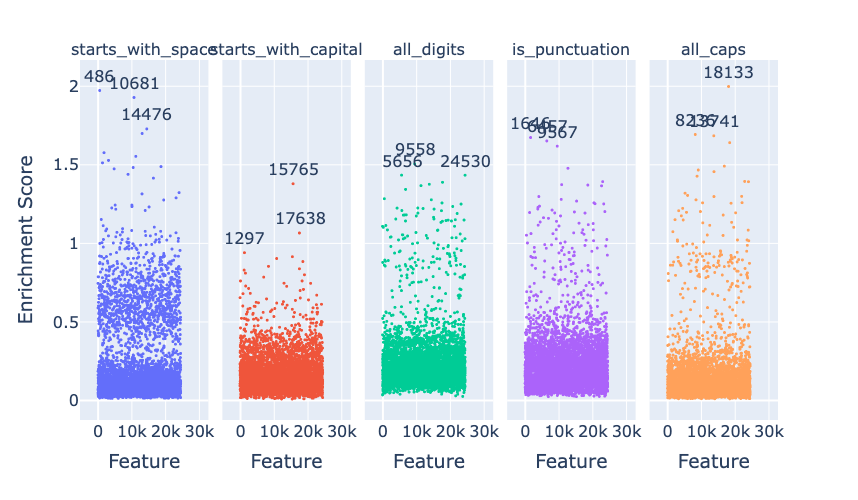

In [88]:
manhattan_plot_enrichment_scores(
    df_enrichment_scores, label_threshold=0, top_n=3  # use our enrichment scores
).show()

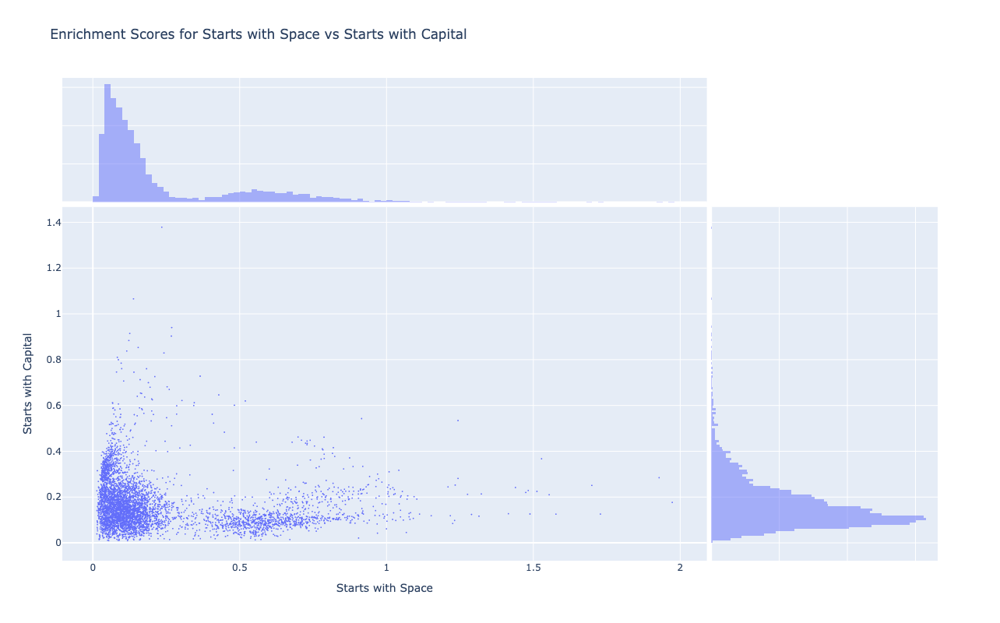

In [96]:
fig = px.scatter(
    df_enrichment_scores.apply(lambda x: -1 * np.log(1 - x)).T,
    x="starts_with_space",
    y="starts_with_capital",
    marginal_x="histogram",
    marginal_y="histogram",
    labels={
        "starts_with_space": "Starts with Space",
        "starts_with_capital": "Starts with Capital",
    },
    title="Enrichment Scores for Starts with Space vs Starts with Capital",
    height=800,
    width=800,
)
# reduce point size on the scatter only
fig.update_traces(marker=dict(size=2), selector=dict(mode="markers"))
fig.show()

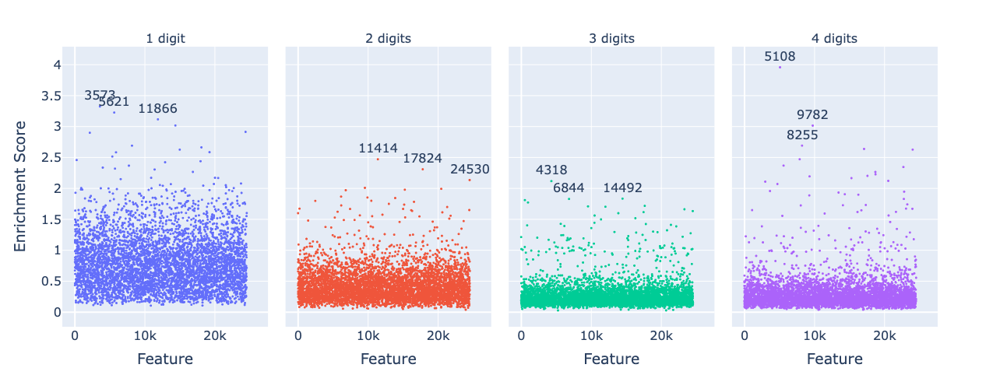

In [97]:
token_sets_index = ["1 digit", "2 digits", "3 digits", "4 digits"]
token_set_selected = {
    k: set(v) for k, v in all_token_sets.items() if k in token_sets_index
}
df_enrichment_scores = get_enrichment_df(
    dec_projection_onto_W_U, features_ordered_by_skew, token_set_selected
)
manhattan_plot_enrichment_scores(df_enrichment_scores).show()

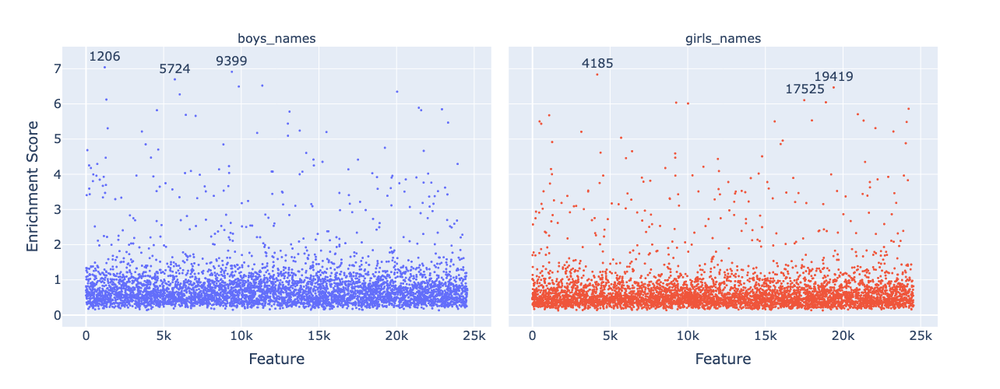

In [104]:
token_sets_index = ["boys_names", "girls_names"]
token_set_selected = {
    k: set(v) for k, v in all_token_sets.items() if k in token_sets_index
}
df_enrichment_scores = get_enrichment_df(
    dec_projection_onto_W_U, features_ordered_by_skew, token_set_selected
)
manhattan_plot_enrichment_scores(df_enrichment_scores).show()

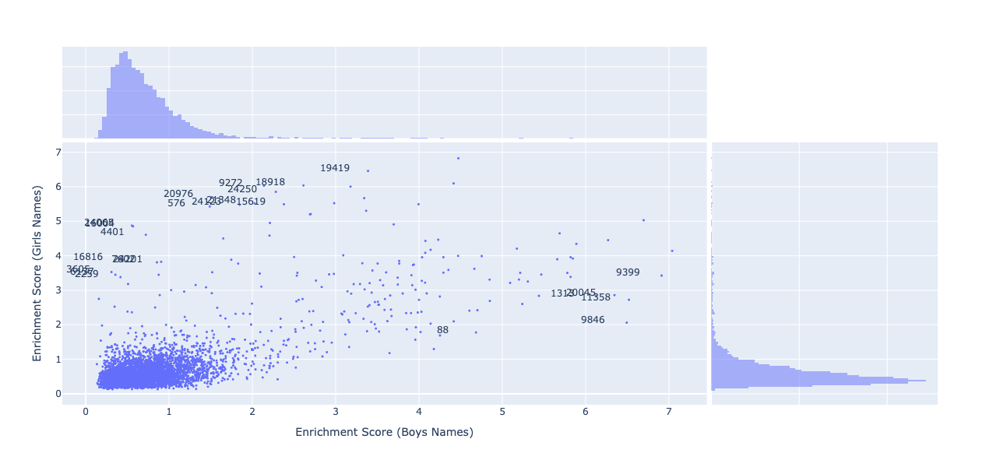

In [105]:
tmp_df = df_enrichment_scores.apply(lambda x: -1 * np.log(1 - x)).T
color = (
    W_U_stats_df_dec.sort_values("skewness", ascending=False)
    .head(5000)["skewness"]
    .values
)
fig = px.scatter(
    tmp_df.reset_index().rename(columns={"index": "feature"}),
    x="boys_names",
    y="girls_names",
    marginal_x="histogram",
    marginal_y="histogram",
    # color = color,
    labels={
        "boys_names": "Enrichment Score (Boys Names)",
        "girls_names": "Enrichment Score (Girls Names)",
    },
    height=600,
    width=800,
    hover_name="feature",
)
# reduce point size on the scatter only
fig.update_traces(marker=dict(size=3), selector=dict(mode="markers"))
# annotate any features where the absolute distance between boys names and girls names > 3
for feature in df_enrichment_scores.columns:
    if abs(tmp_df["boys_names"][feature] - tmp_df["girls_names"][feature]) > 2.9:
        fig.add_annotation(
            x=tmp_df["boys_names"][feature] - 0.4,
            y=tmp_df["girls_names"][feature] + 0.1,
            text=f"{feature}",
            showarrow=False,
        )


fig.show()

### Digging into Particular Features

1206     0.999124
9399     0.999005
5724     0.998766
11358    0.998527
9846     0.998487
Name: boys_names, dtype: float32
[1206, 9399, 5724, 11358, 9846]
boys_names
1206


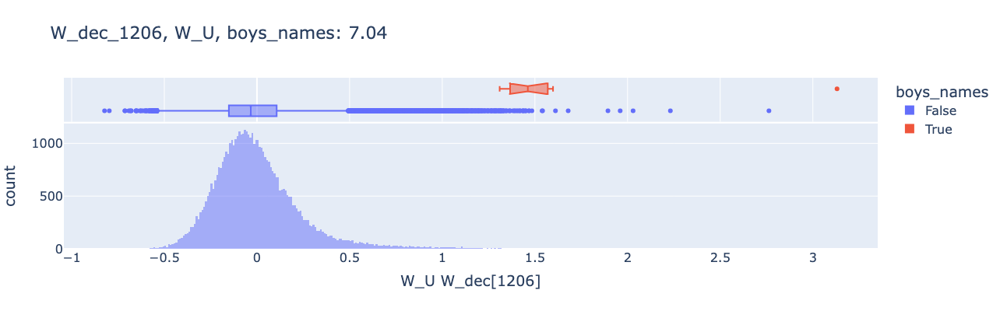

9399


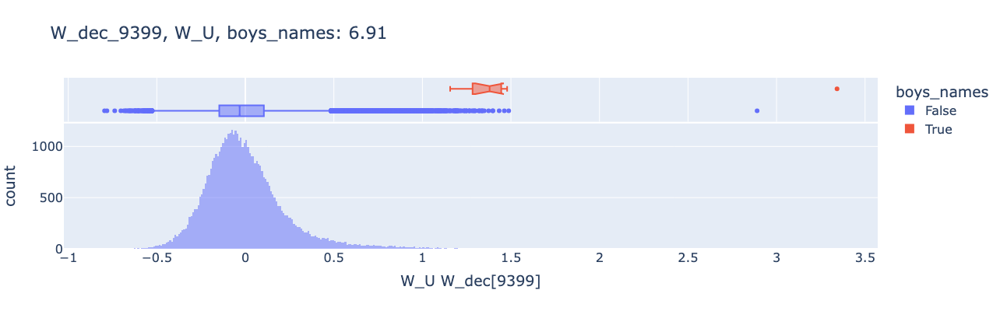

5724


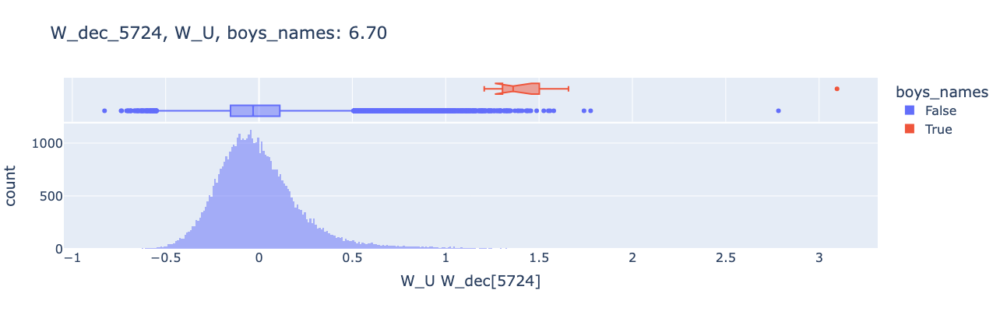

11358


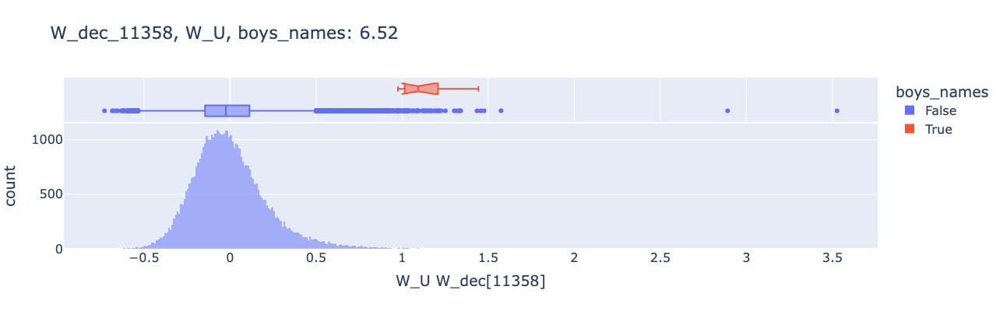

9846


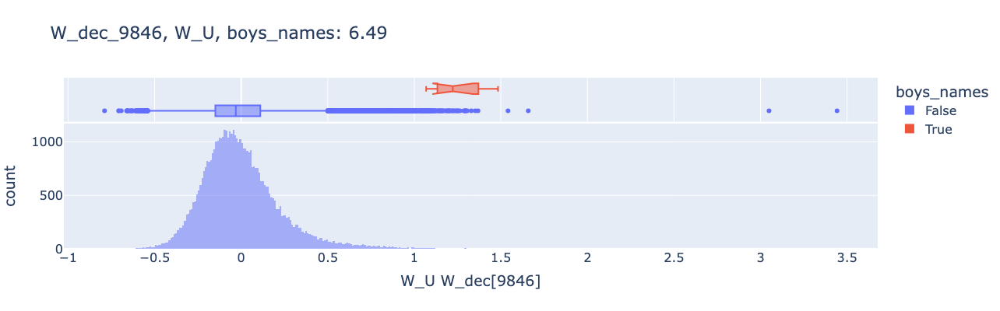

In [106]:
for category in ["boys_names"]:
    plot_top_k_feature_projections_by_token_and_category(
        token_set_selected,
        df_enrichment_scores,
        category=category,
        dec_projection_onto_W_U=dec_projection_onto_W_U,
        model=model,
        log_y=False,
        histnorm=None,
    )